#WIKIPEDIA ANALYSIS EXERCISE

In the first part of this notebook, the goal is to analyse a collection of Wikipedia documents and to return statistics such as document number, word average, etc, for each of the 15 categories provided. For each category, a representative wordcloud is also generated.

In the second part a category classification model is trained and tested on both *summary* and *documents* variables.

##Exploratory data analysis and wordclouds

I install useful libraries that will be used in the notebook.
In particular, the following 2 instructions were suggested in the Discord channel as I was having the known *"TrueType fonts error"* too.

In [0]:
%pip install --upgrade Pillow

Python interpreter will be restarted.
  Attempting uninstall: Pillow
    Found existing installation: Pillow 9.0.1
    Not uninstalling pillow at /databricks/python3/lib/python3.9/site-packages, outside environment /local_disk0/.ephemeral_nfs/envs/pythonEnv-83788198-910f-4acf-8c1c-465ad76c205c
    Can't uninstall 'Pillow'. No files were found to uninstall.
Python interpreter will be restarted.


In [0]:
dbutils.library.restartPython()

In [0]:
pip install wordcloud

Python interpreter will be restarted.
Python interpreter will be restarted.


Dataset loading, as suggested.

In [0]:
!wget https://proai-datasets.s3.eu-west-3.amazonaws.com/wikipedia.csv
import pandas as pd
dataset = pd.read_csv('/databricks/driver/wikipedia.csv')
spark_df = spark.createDataFrame(dataset)
spark_df = spark_df.drop("Unnamed: 0")
spark_df.write.saveAsTable("wikipedia_24")

--2024-10-02 08:29:01--  https://proai-datasets.s3.eu-west-3.amazonaws.com/wikipedia.csv
Resolving proai-datasets.s3.eu-west-3.amazonaws.com (proai-datasets.s3.eu-west-3.amazonaws.com)... 3.5.226.145, 16.12.18.14
Connecting to proai-datasets.s3.eu-west-3.amazonaws.com (proai-datasets.s3.eu-west-3.amazonaws.com)|3.5.226.145|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1003477941 (957M) [text/csv]
Saving to: ‘wikipedia.csv’

wikipedia.csv       100%[===================>] 956.99M  21.0MB/s    in 47s     

2024-10-02 08:29:48 (20.6 MB/s) - ‘wikipedia.csv’ saved [1003477941/1003477941]



Let's take a look at the dataset and its variables.

In [0]:
display(spark_df)

title summary documents categoria economics economics () is a social science that studies the production, distribution, and consumption of goods and services.economics focuses on the behaviour and interactions of economic agents and how economies work. microeconomics analyzes what's viewed as basic elements in the economy, including individual agents and markets, their interactions, and the outcomes of interactions. individual agents may include, for example, households, firms, buyers, and sellers. macroeconomics analyzes the economy as a system where production, consumption, saving, and investment interact, and factors affecting it: employment of the resources of labour, capital, and land, currency inflation, economic growth, and public policies that have impact on these elements. other broad distinctions within economics include those between positive economics, describing "what is", and normative economics, advocating "what ought to be"; between economic theory and applied economics; between rational and behavioural economics; and between mainstream economics and heterodox economics.economic analysis can be applied throughout society, including business, finance, cybersecurity, health care, engineering and government. it is also applied to such diverse subjects as crime, education, the family, feminism, law, philosophy, politics, religion, social institutions, war, science, and the environment. economics () is a social science that studies the production, distribution, and consumption of goods and services.economics focuses on the behaviour and interactions of economic agents and how economies work. microeconomics analyzes what's viewed as basic elements in the economy, including individual agents and markets, their interactions, and the outcomes of interactions. individual agents may include, for example, households, firms, buyers, and sellers. macroeconomics analyzes the economy as a system where production, consumption, saving, and investment interact, and factors affecting it: employment of the resources of labour, capital, and land, currency inflation, economic growth, and public policies that have impact on these elements. other broad distinctions within economics include those between positive economics, describing "what is", and normative economics, advocating "what ought to be"; between economic theory and applied economics; between rational and behavioural economics; and between mainstream economics and heterodox economics.economic analysis can be applied throughout society, including business, finance, cybersecurity, health care, engineering and government. it is also applied to such diverse subjects as crime, education, the family, feminism, law, philosophy, politics, religion, social institutions, war, science, and the environment. definitions of economics over time the earlier term for the discipline was 'political economy', but since the late 19th century, it has commonly been called 'economics'. the term is ultimately derived from ancient greek οἰκονομία (oikonomia) which is a term for the "way (nomos) to run a household (oikos)", or in other words the know-how of an οἰκονομικός (oikonomikos), or "household or homestead manager". derived terms such as "economy" can therefore often mean "frugal" or "thrifty". by extension then, "political economy" was the way to manage a polis or state. there are a variety of modern definitions of economics; some reflect evolving views of the subject or different views among economists. scottish philosopher adam smith (1776) defined what was then called political economy as "an inquiry into the nature and causes of the wealth of nations", in particular as: a branch of the science of a statesman or legislator [with the twofold objectives of providing] a plentiful revenue or subsistence for the people ... [and] to supply the state or commonwealth with a revenue for the publick services. jean-baptiste say (1803), distinguishing the subject matter from its public-policy uses, def

In [0]:
spark_df.schema

Out[3]: StructType([StructField('title', StringType(), True), StructField('summary', StringType(), True), StructField('documents', StringType(), True), StructField('categoria', StringType(), True)])

In [0]:
spark_df.count()

Out[4]: 153232

In [0]:
display(spark_df.groupby('categoria').count())

categoria,count
economics,10110
politics,11358
culture,10372
science,10236
sports,10068
energy,10046
finance,10157
humanities,10236
pets,10023
trade,10068


The dataset, as supplied, has 153.232 samples distributed in a balanced way among 15 categories.

In order to correctly count documents and words, I remove from the dataset duplicates and samples with missing data.

In [0]:
df = spark_df.na.drop()
df = df.dropDuplicates()
df.count()

Out[6]: 75523

In [0]:
display(df.groupby('categoria').count())

categoria,count
finance,5582
medicine,8311
research,7573
technology,6750
energy,4641
transport,7936
politics,243
culture,2175
science,3724
humanities,5854


The dataset has many duplicates, as the total number of documents dropped to 75.523. In particular, the category "politics" now counts only 243 documents. Let's take a look at this category.

In [0]:
from pyspark.sql.functions import col

spark_df_politics_count = spark_df.where(spark_df.categoria=='politics').groupBy('title').count()
display(spark_df_politics_count.orderBy(col('count').desc()))

title,count
hansonism,508
pauline hanson's one nation,508
pauline's united australia party,507
stephen andrew,507
fraser anning,506
rikkie-lee tyrrell,506
mark latham,506
pauline hanson,506
pauline hanson's one nation – south australia,254
city country alliance,254


By filtering the original dataset by the category "politics" it is possible to notice how many duplicates were present.

Now let's clean the documents text in order to remove punctuation and double whitespaces.

In [0]:
from pyspark.sql.functions import regexp_replace
from pyspark.sql.functions import col

df = df.withColumn('documents', regexp_replace(col('documents'), '[^\w\s]', ''))
df = df.withColumn('documents', regexp_replace(col('documents'), '\s+', ' '))


display(df)

title summary documents categoria david cooperrider david cooperrider (born july 14, 1954), is the fairmount minerals chair and professor of social entrepreneurship at the weatherhead school of management at case western reserve university, and faculty director at the center for business as an agent of world benefit at case.cooperrider also teaches at university of pennsylvania as well as claremont university, where he is the peter f. drucker distinguished fellow.cooperrider is the founder, together with suresh srivastva, of the theory of appreciative inquiry. cooperrider's original doctoral dissertation "appreciative inquiry into organizational life" has been cited as “the first, and as yet, the best articulation of the theory and vision of appreciative inquiry.” it was completed and defended in 1985. david cooperrider born july 14 1954 is the fairmount minerals chair and professor of social entrepreneurship at the weatherhead school of management at case western reserve university and faculty director at the center for business as an agent of world benefit at casecooperrider also teaches at university of pennsylvania as well as claremont university where he is the peter f drucker distinguished fellowcooperrider is the founder together with suresh srivastva of the theory of appreciative inquiry cooperriders original doctoral dissertation appreciative inquiry into organizational life has been cited as the first and as yet the best articulation of the theory and vision of appreciative inquiry it was completed and defended in 1985 early life and education cooperrider grew up in oak park illinois and later completed his undergraduate studies at augustana college in 1976 he earned a masters of science at sir george williams university in 1983 and his phd from case western reserve university in 1985 appreciative inquiry appreciative inquiry was articulated first as a method for building generative theory it was a call for a scholarship of the positive focusing attention on what gives life to human and ecological systems when they are most alive appreciative inquiry is related to theories and practices such as organization development strengthsbased management applied positive psychology evaluation studies change management coaching and counseling corporate strategy sustainable development social constructionism design thinking biomimicry and learning theoryin a new york times bestselling book marcus buckingham concluded that the theory of appreciative inquiry was one of the three most important academic catalysts for the strengths revolution in management beyond the seminal work of cooperrider and srivastva the other two giant sources of the strengths revolution in management included peter druckers effective executive and martin seligmans call for a positive psychology in 2000 together appreciative inquiry druckers management theory and positive psychology have created a societywide positivestrengths movement because it workswhat is big idea of appreciative inquiry it began with the observation that ever since taylorism managers researchers and consultants have seen organizations not only in machinelike terms but in deficitbased terms as problems to be solved or fixed true to abraham maslows observation that if all you have is a hammer everything looks like a nail those same managers and consultants became over the years quite good at finding analyzing and sometimes solving problems in organizations so much so that organizations became problems personifiedand hence a whole vocabulary of deficitbased change grew up centered on concepts like gap analysis organizational diagnosis root causes of failure resistance unfreezing needs analysis threat analysis and the need for high levels of dissatisfaction and urgent burning platforms much like diagnostic medicine with its focus on illness management had become locked in a problemanalytic view of the world especially when it came to concepts and tools for managing changeearly in the 1980s

I create a new column with the tokens array for each document and another column with the size of the token array, which is also the document length measured in number of words.

In [0]:
from pyspark.ml.feature import Tokenizer
from pyspark.sql.functions import size

tokenizer = Tokenizer(inputCol='documents', outputCol='tokens')
df_tok = tokenizer.transform(df)
df_tok = df_tok.withColumn('doc_len', size('tokens'))
display(df_tok.orderBy('doc_len'))

title,summary,documents,categoria,tokens,doc_len
companies listed on the new york stock exchange,== v ==,v,finance,"List(, v)",2
companies listed on the new york stock exchange,== b ==,b,finance,"List(, b)",2
companies listed on the new york stock exchange,== r ==,r,finance,"List(, r)",2
companies listed on the new york stock exchange,== m ==,m,finance,"List(, m)",2
companies listed on the new york stock exchange,== i ==,i,finance,"List(, i)",2
companies listed on the new york stock exchange,== q ==,q,finance,"List(, q)",2
companies listed on the new york stock exchange,== f ==,f,finance,"List(, f)",2
companies listed on the new york stock exchange,== h ==,h,finance,"List(, h)",2
companies listed on the new york stock exchange,== o ==,o,finance,"List(, o)",2
companies listed on the new york stock exchange,== s ==,s,finance,"List(, s)",2


Sorting the dataframe by document length, I notice some 2 words long documents with no real information. Therefore I filter out these samples.

In [0]:
df_tok = df_tok.where(df_tok.doc_len>2)

I am now able to query the dataframe and get the desired statistics, grouped by category, in a single table.

In [0]:
query = 'select categoria as Category, count(documents) as Total_documents, round(avg(doc_len),1) as Word_average, max(doc_len) as Longest_document, min(doc_len) as Shortest_document from df_tok group by categoria order by categoria'

df_tok.createOrReplaceTempView('df_tok')
df_counters = spark.sql(query)
display(df_counters)

Category,Total_documents,Word_average,Longest_document,Shortest_document
culture,2175,862.1,15446,9
economics,4263,893.1,23833,8
energy,4641,610.1,23201,9
engineering,6133,759.9,11837,8
finance,5555,1616.3,33442,21
humanities,5854,1076.1,23186,7
medicine,8311,773.5,18412,10
pets,4825,412.6,13217,10
politics,243,2001.7,20112,9
research,7573,688.4,27211,15


In order to print a wordcloud for each category, I save the categories names in a set.<br/>
Then I define a function that saves every document in a list, and then these documents are joined in order to create a single list containing all the words of the documents. This word list is then used to generate the **wordcloud**, using the Wordcloud library.<br/>
The dataframe is then filtered by each category and each portion is used for the generation of the wordcloud.

In [0]:
from pyspark.sql.functions import collect_set

cat_list = df.agg(collect_set('categoria')).collect()[0][0]
cat_list.sort()

print(cat_list)

['culture', 'economics', 'energy', 'engineering', 'finance', 'humanities', 'medicine', 'pets', 'politics', 'research', 'science', 'sports', 'technology', 'trade', 'transport']


In [0]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
from pyspark.sql.functions import collect_list

def print_wordcloud (df, category):
    word_list = df.agg(collect_list('documents')).collect()[0][0]
    cloud_text = ' '.join(word_list)
    wordcloud = WordCloud(width=600, height=300, background_color='white').generate(cloud_text)
    print('Wordcloud ',category)
    plt.figure(figsize=(10, 6))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.show()
    return

Wordcloud  culture


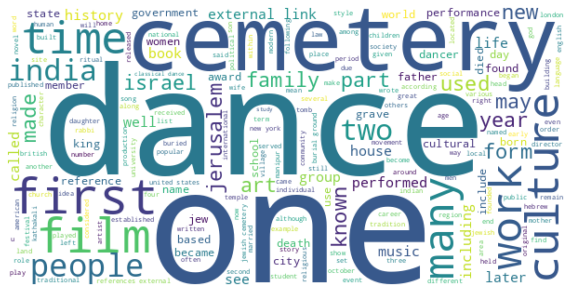

------------------------------------------------------
Wordcloud  economics


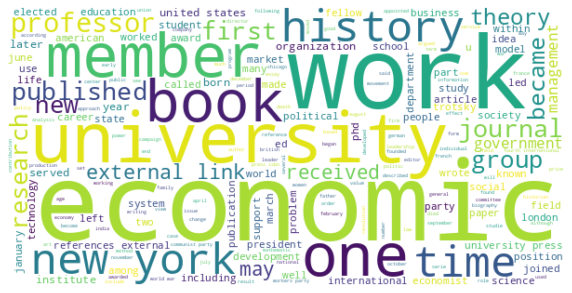

------------------------------------------------------
Wordcloud  energy


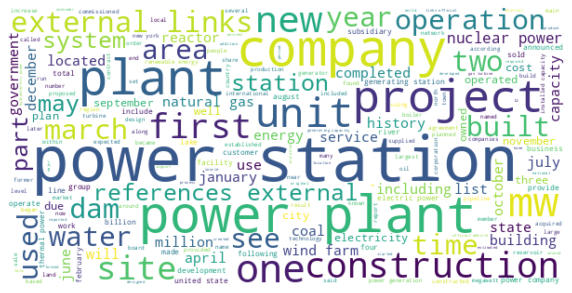

------------------------------------------------------
Wordcloud  engineering


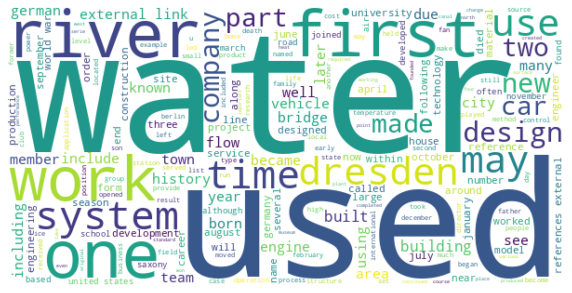

------------------------------------------------------
Wordcloud  finance


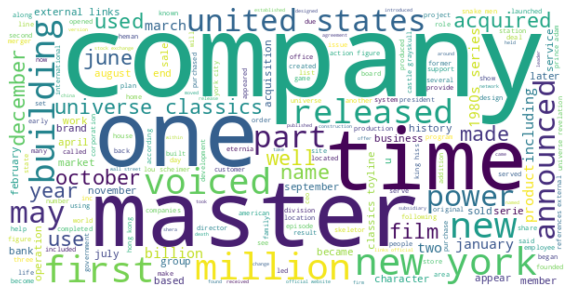

------------------------------------------------------
Wordcloud  humanities


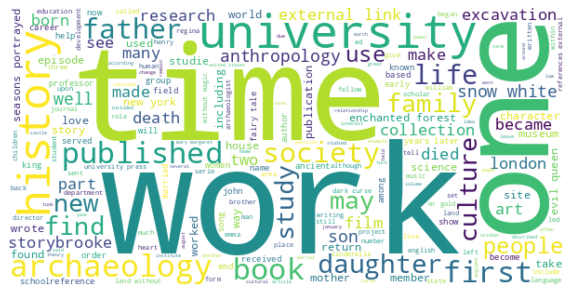

------------------------------------------------------
Wordcloud  medicine


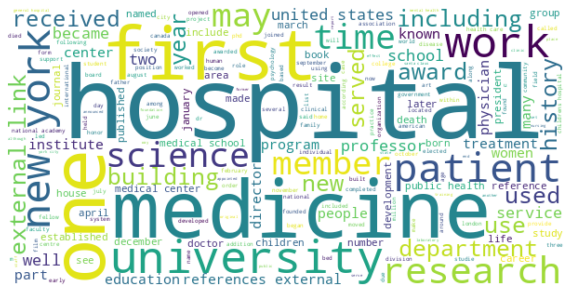

------------------------------------------------------
Wordcloud  pets


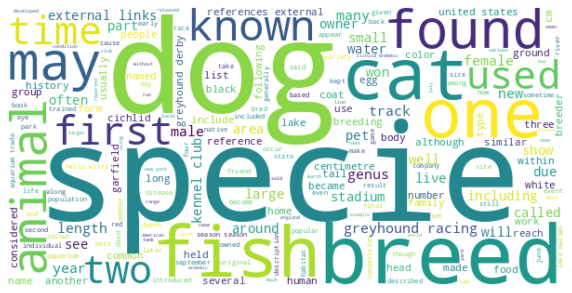

------------------------------------------------------
Wordcloud  politics


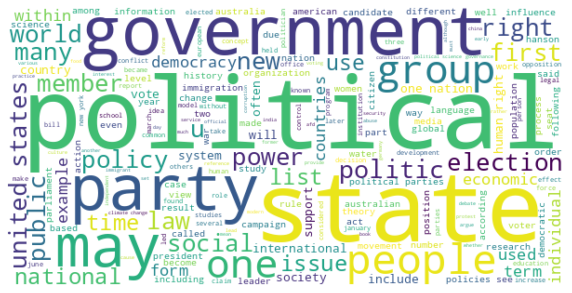

------------------------------------------------------
Wordcloud  research


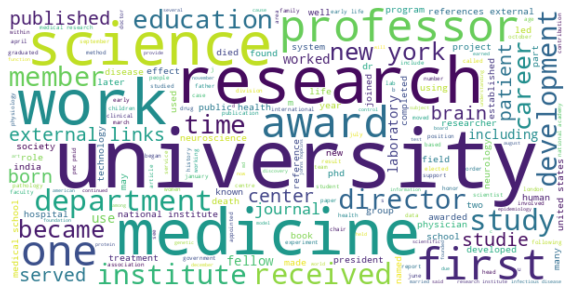

------------------------------------------------------
Wordcloud  science


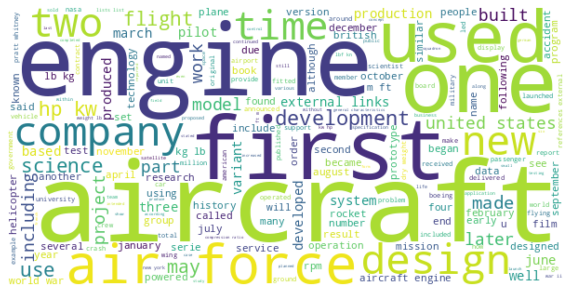

------------------------------------------------------
Wordcloud  sports


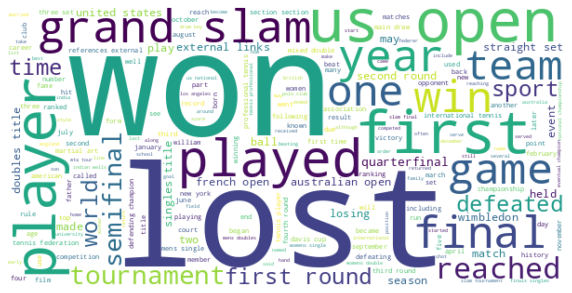

------------------------------------------------------
Wordcloud  technology


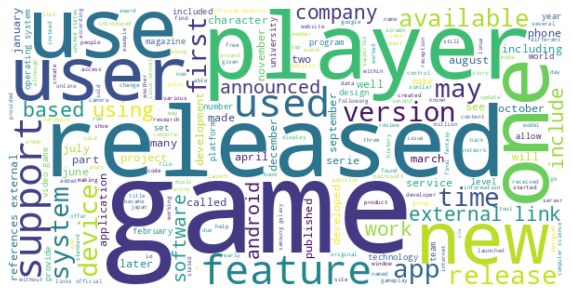

------------------------------------------------------
Wordcloud  trade


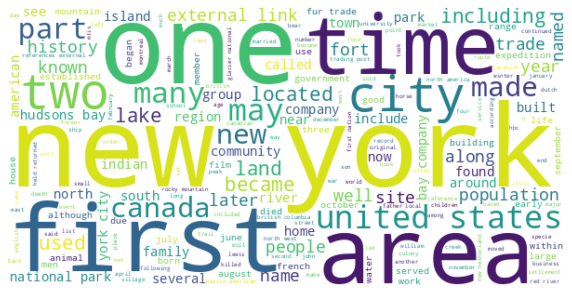

------------------------------------------------------
Wordcloud  transport


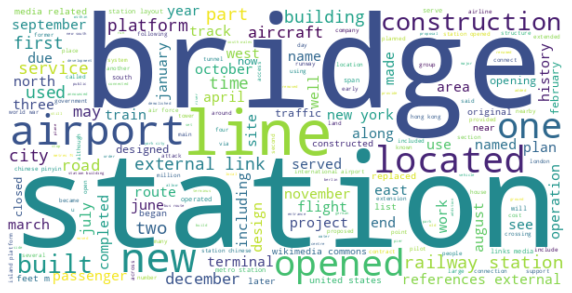

------------------------------------------------------


In [0]:
for cat in cat_list:
    df_cat = df_tok.where(df_tok.categoria==cat)
    print_wordcloud(df_cat, cat)
    print('------------------------------------------------------')

##Classification model

As the model needs to be trained on both *summary* and *documents* I define the following functions for a more convenient work.

In [0]:
def feature_cleaner (df, feature):
    """
    Removes punctuation, numbers, double whitespaces from the given string column 'feature' of a dataframe.
    Then samples with missing values are removed.
    """
    df = df.withColumn(feature, regexp_replace(col('documents'), '[^\w\s]', ''))
    df = df.withColumn(feature, regexp_replace(col('documents'), '\d', ''))
    df = df.withColumn(feature, regexp_replace(col('documents'), '\s+', ' '))
    df = df.na.drop()
    return df

In [0]:
from pyspark.ml.feature import CountVectorizer,StandardScaler, StopWordsRemover, StringIndexer
from pyspark.ml import Pipeline
from pyspark.ml.classification import NaiveBayes

def create_model_nb (df_train, feature):
    """
    Preprocessing and training of a clean column 'feature' of a given train set with a pipeline.
    Encoding of labels column 'categoria'.
    Returns a fit multinomial Naive Bayes model.
    """
    indexer = StringIndexer(inputCol='categoria', outputCol='label')
    tokenizer = Tokenizer(inputCol=feature, outputCol='tokens')
    stopwords = StopWordsRemover(inputCol='tokens', outputCol='clean_tokens')
    counter = CountVectorizer(inputCol='clean_tokens', outputCol='vector')
    nb = NaiveBayes(modelType='multinomial', featuresCol='vector',labelCol='label')
    pipe = Pipeline(stages = [indexer, tokenizer, stopwords, counter,nb])
    return pipe.fit(df_train)

In [0]:
from pyspark.ml.evaluation import MulticlassClassificationEvaluator

def evaluate_model (df_test, model):
    """
    Evaluates model performance on a given test set with a multiclass classification evaluator.
    Returns accuracy score.
    """
    test_pred = model.transform(df_test)
    evaluator = MulticlassClassificationEvaluator(labelCol='label', metricName='accuracy')
    return round(evaluator.evaluate(test_pred),2)

The functions above are then wrapped in the following function *column_classifier*.</br>
*Column_classifier* takes the column of interest as argument, along with the dataset **as supplied**. The dataset then is preprocessed but for this part of the exercise the duplicates are preserved, in order to keep the **categories balanced**.</br>
The given column, named *feature*, is cleaned with *feature_cleaner*, then the dataframe is split in train and test set. With *create_model_nb* the data is furtherly preprocessed and a multinomial naive bayes model is trained. The model is evaluated on the test set by *evaluate_model*.</br>
In order to conveniently see the process, the transformed train set is shown.</br>
Eventually, the accuracy score on the test set is printed.

In [0]:
def column_classifier (df, feature):
    df_clean = feature_cleaner(df, feature)
    train,test = df_clean.randomSplit([0.8,0.2],seed=0)
    model_nb = create_model_nb(train, feature)
    #display(model_nb.transform(train)) commentato per ridurre il testo e poter evitare il relativo errore e condividere il notebook per la correzione
    accu = evaluate_model(test, model_nb)
    print('Model trained on column',feature,'. Accuracy on test set = ',accu)
    return

In [0]:
column_classifier(spark_df, 'summary')

Model trained on column summary . Accuracy on test set =  0.88


In [0]:
column_classifier(spark_df, 'documents')

Model trained on column documents . Accuracy on test set =  0.89


The accuracy of the two classifiers is essentially the same, but the model trained on *documents* has a slightly higher accuracy score.